# Letter Recognition Dataset
The ([Letter Recognition Dataset](https://archive.ics.uci.edu/dataset/59/letter+recognition)) is a compilation of data used to identify letters based on various features. It is sourced from the UCI Machine Learning Repository and serves as a popular dataset for exploring classification techniques and pattern recognition modeling.

The dataset includes 20,000 samples, classified into 26 letter categories, representing the letters of the alphabet from A to Z.

## Importing Packages

In [85]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
from sklearn import tree
import graphviz
from ucimlrepo import fetch_ucirepo

## Preparing the datasets
### Fetching the Datasets
Fetch the 'Letter Recognition' dataset from UCI

In [86]:
letter_recognition = fetch_ucirepo(id=59) 

### Setting Up the Training and Test Datasets
We will split the original dataset into 4 different splitting strategies, with the proportion of traning and test as follows: 40/60, 60/40, 80/20, and 90/10.

First, we split the original dataset into feature and label columns, as the target we are considering now is `lettr`

In [87]:
lettr_rec_features = letter_recognition.data.features
lettr_rec_target = letter_recognition.data.targets

Then the feature and label are split into 4 splitting strategies as mentioned above.

In [88]:
training_sizes = {
    "40/60": 0.4,
    "60/40": 0.6,
    "80/20": 0.8,
    "90/10": 0.9,
}

datasets = {}

for name, train_size in training_sizes.items():
    features_train, features_test, target_train, target_test = train_test_split(
        lettr_rec_features, lettr_rec_target, 
        test_size=1-train_size, 
        train_size=train_size, 
        shuffle=True, 
        stratify=lettr_rec_target,
        random_state=42
    )

    datasets[name] = {
        "features_train": features_train, 
        "features_test": features_test, 
        "target_train": target_train, 
        "target_test": target_test
    }

After splitting the datasets, the visualization of the class distribution is as follows.

#### Original Set

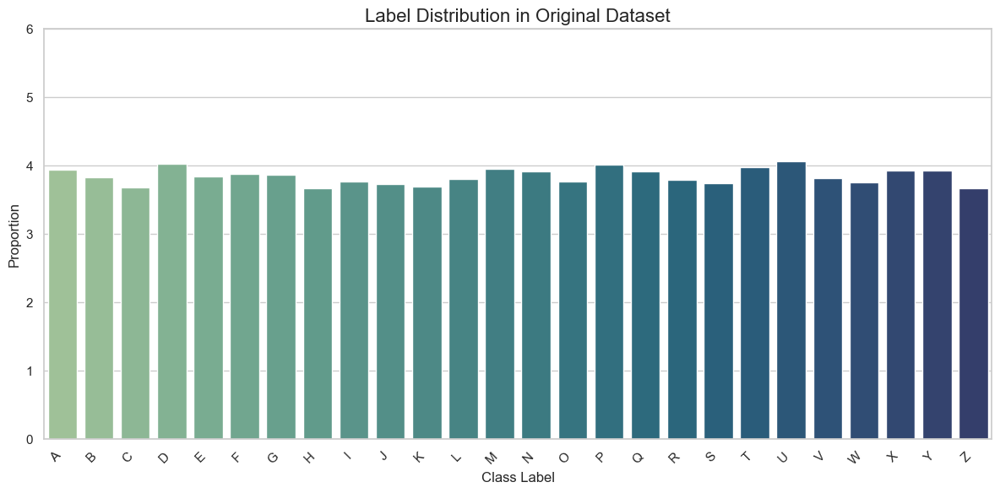

In [89]:
data = lettr_rec_target['lettr']
data_series = pd.Series(data).squeeze()
value_counts = (data_series.value_counts(normalize=True)*100).sort_index()
plt.figure(figsize=(12,6))
sns.set(style="whitegrid")    
sns.barplot(x=value_counts.index, hue=value_counts.index, y = value_counts.values, palette="crest", legend=False)
plt.title("Label Distribution in Original Dataset", fontsize=16)
plt.xlabel("Class Label", fontsize=12)
plt.ylabel("Proportion", fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.ylim(0, 6) #26 classes, so 6% is a good limit
plt.tight_layout()
plt.show()

#### Training Set

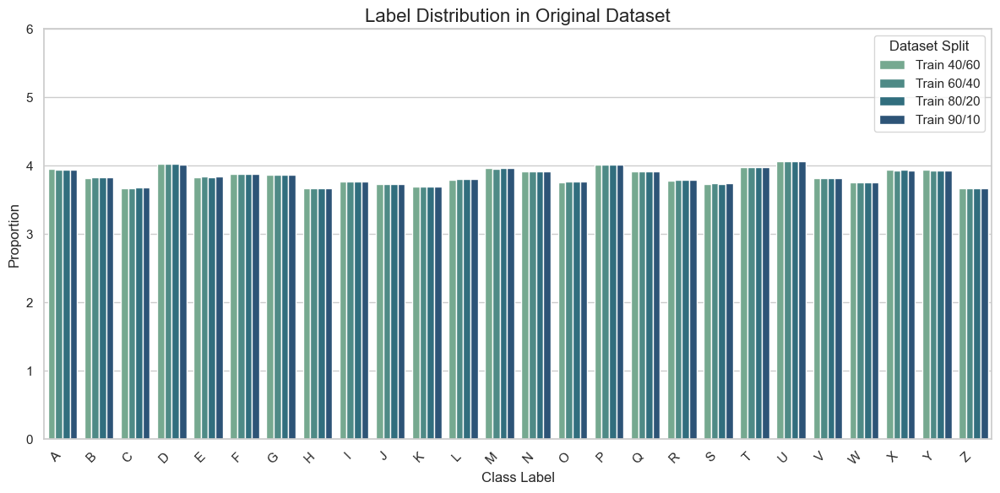

In [90]:
def plot_combined_distribution_bar(datasets, target_key, title):
    combined_data = []
    for name, dataset in datasets.items():
        data = dataset[target_key].squeeze()
        label_counts = (data.value_counts(normalize=True) * 100).sort_index()
        for label, proportion in label_counts.items():
            combined_data.append({
                "Label": label,
                "Proportion": proportion,
                "Split": f"{target_key.replace('target_', '').capitalize()} {name}"
            })

    df_combined = pd.DataFrame(combined_data)
    
    plt.figure(figsize=(12,6))
    sns.set(style="whitegrid")    
    sns.barplot(data=df_combined, x="Label", y="Proportion", hue="Split", palette="crest")
    plt.title("Label Distribution in Original Dataset", fontsize=16)
    plt.xlabel("Class Label", fontsize=12)
    plt.ylabel("Proportion", fontsize=12)
    plt.xticks(rotation=45, ha='right')
    plt.ylim(0, 6) #26 classes, so 6% is a good limit
    plt.legend(title="Dataset Split")
    plt.tight_layout()
    plt.show()

plot_combined_distribution_bar(datasets, "target_train", "Label Distribution in Training Sets")

#### Test Set

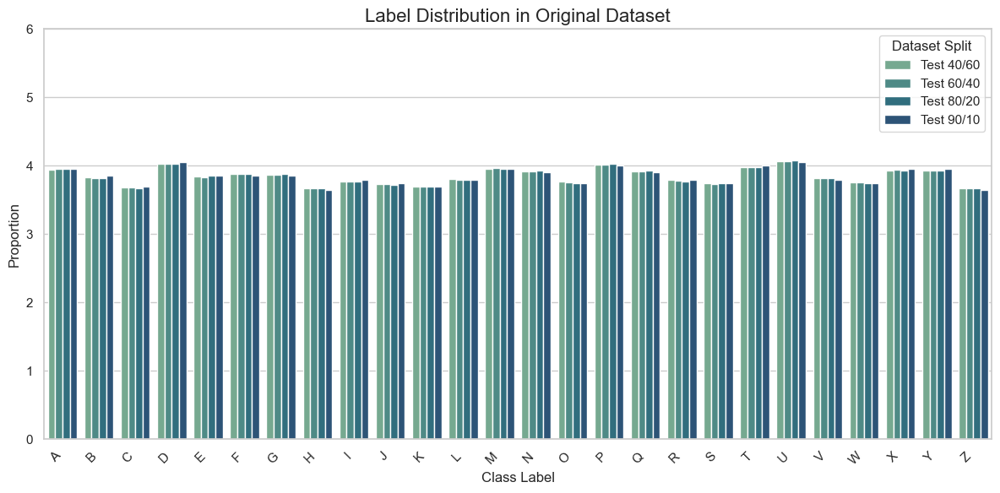

In [91]:
plot_combined_distribution_bar(datasets, "target_test", "Label Distribution in Test Sets")

The visualizations clearly demonstrate that stratified sampling was applied successfully across all training and test splits. Despite slight variations caused by rounding during the splitting process, the class proportions remain consistent and closely aligned with the original dataset. This ensures that each subset maintains a balanced representation of all 26 classes, providing a fair basis for training and evaluating classification models.

## Building the Decision Tree Classifiers

After preparing the datasets, we now fit a Decision Tree Classifier to each training set and visualize the decision tree result.

### Model Training
We apply the `DecisionTreeClassifier` on each splitted subsets. To use information gain, we set `criterion` parameter to be `'entropy'`, and `random_state` is set to `42` for mainaining consistency between the notebook and the report.

In [92]:
models = {}

for name, dataset in datasets.items():
    X_train = dataset["features_train"]
    y_train = dataset["target_train"].squeeze()

    model = tree.DecisionTreeClassifier(criterion="entropy", random_state=42)
    model.fit(X_train, y_train)

    models[name] = model

### Visualization
The visualization of the resulting decision trees is processed with Graphviz. We set `class_names` to be the label names for easy reading when visualizing the trees.

In [93]:
graphs = {}

for name, model in models.items():
    dot_data = tree.export_graphviz(
        model, 
        out_file=None,
        filled=True,
        rounded=True,
        class_names=model.classes_,
    )
    graph = graphviz.Source(dot_data)
    graphs[name] = graph


Decision Tree Graph for 40/60 splitting.

In [94]:
graphs['40/60']

Decision Tree Graph for 60/40 splitting.

In [95]:
graphs['60/40']

Decision Tree Graph for 80/20 splitting.

In [96]:
graphs['80/20']

Decision Tree Graph for 90/10 splitting.

In [97]:
graphs['90/10']

## Evaluating the Decison Tree Classifiers

For each of the trained classifiers, we will predict the samples using test set and use them, with `classification_report` and `confusion_matrix`, to generate the classification report and the confusion matrix.

First, we define the function for displaying necessary information. The function uses the generated `confusion_matrix` and `ConfusionMatrixDisplay` from `sklearn` to display the confusion matrix.

In [98]:
def evaluating_tree_classifiers(model, name):
    X_test = datasets[name]["features_test"]
    y_test = datasets[name]["target_test"].squeeze()
    y_pred = model.predict(X_test)
    
    report_dict = classification_report(
        y_test, y_pred, labels=model.classes_, output_dict=True
    )
    report_df = pd.DataFrame(report_dict).transpose()

    display(report_df.round(2))

    cm = confusion_matrix(y_test, y_pred, labels=model.classes_)
    depth = model.get_depth()
    
    plt.figure(figsize=(10, 8))
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
    disp.plot(cmap='Blues', values_format='d', xticks_rotation='vertical', ax=plt.gca())
    plt.title(f"Confusion Matrix (Depth={depth}, {name} Split)")
    plt.tight_layout()
    plt.grid(False)
    plt.show()

Then, after applying the function to every splitting strategies, the evaluation of those trees are illustrated as follows:

### a. 40/60 Splitting

,precision,recall,f1-score,support
A,0.93,0.93,0.93,473.00
B,0.76,0.82,0.79,460.00
C,0.85,0.88,0.87,442.00
D,0.81,0.83,0.82,483.00
E,0.84,0.87,0.86,461.00
F,0.77,0.78,0.77,465.00
G,0.79,0.83,0.81,464.00
H,0.73,0.72,0.72,440.00
I,0.89,0.83,0.86,453.00
J,0.86,0.91,0.88,448.00


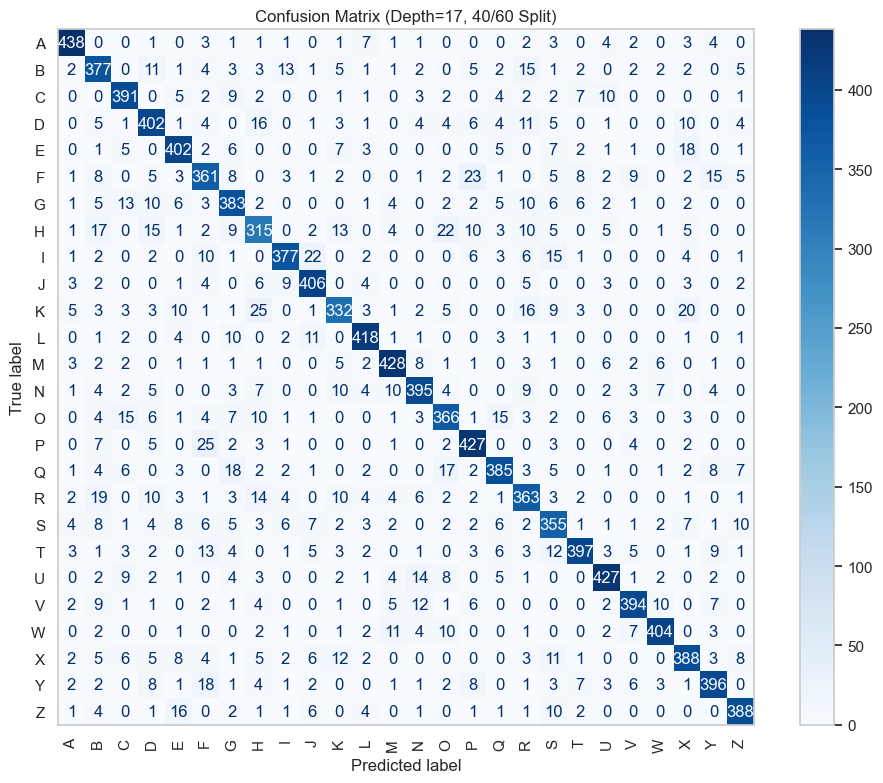

In [99]:

evaluating_tree_classifiers(models['40/60'], '40/60')

#### Evaluation and insights:
**Classification Report:**

- **`A`:** The model performs well, with a precision of 0.93 and recall of 0.93, resulting in a high f1-score of 0.93. With a support of 473 samples, this class is well represented and clearly learned by the model.

- **`B`:** The model shows decent performance, with a precision of 0.76 and recall of 0.82, yielding an f1-score of 0.79. Supported by 460 samples, this class is reasonably well detected.

- **`C`:** The model performs strongly, with a precision of 0.85 and recall of 0.88, resulting in an f1-score of 0.87. With 442 samples, this class is effectively learned.

- **`D`:** The model achieves a precision of 0.81 and recall of 0.83, leading to an f1-score of 0.82. With 483 samples, this class is well represented.

- **`E`:** The model performs consistently, with a precision of 0.84 and recall of 0.87, yielding an f1-score of 0.86. Supported by 461 samples, the class is well detected.

- **`F`:** The model shows moderate performance, with a precision of 0.77 and recall of 0.78, resulting in an f1-score of 0.77. With 465 samples, this class is adequately learned.

- **`G`:** The model performs well, with a precision of 0.79 and recall of 0.83, leading to an f1-score of 0.81. With 464 samples, this class is effectively represented.

- **`H`:** The model achieves a precision of 0.73 and recall of 0.72, resulting in an f1-score of 0.72. With 440 samples, this class shows room for improvement.

- **`I`:** The model performs strongly, with a precision of 0.89 and recall of 0.83, yielding an f1-score of 0.86. Supported by 453 samples, this class is well detected.

- **`J`:** The model excels with a precision of 0.86 and recall of 0.91, resulting in an f1-score of 0.88. With 448 samples, this class is confidently classified.

- **`K`:** The model shows moderate performance, with a precision of 0.81 and recall of 0.75, leading to an f1-score of 0.78. With 443 samples, this class shows room for improvement.

- **`L`:** The model performs excellently, with a precision of 0.90 and recall of 0.91, resulting in an f1-score of 0.90. Supported by 457 samples, this class is well detected.

- **`M`:** The model excels, with a precision of 0.89 and recall of 0.90, yielding an f1-score of 0.90. With 475 samples, this class is confidently classified.

- **`N`:** The model performs well, with a precision of 0.86 and recall of 0.84, resulting in an f1-score of 0.85. Supported by 470 samples, this class is adequately learned.

- **`O`:** The model shows consistent performance, with a precision of 0.81 and recall of 0.81, leading to an f1-score of 0.81. With 452 samples, this class is well represented.

- **`P`:** The model performs strongly, with a precision of 0.85 and recall of 0.89, resulting in an f1-score of 0.87. Supported by 482 samples, this class is effectively learned.

- **`Q`:** The model achieves a precision of 0.86 and recall of 0.82, yielding an f1-score of 0.84. With 470 samples, this class is adequately represented.

- **`R`:** The model shows moderate performance, with a precision of 0.77 and recall of 0.80, resulting in an f1-score of 0.78. With 455 samples, this class shows room for improvement.

- **`S`:** The model performs moderately, with a precision of 0.77 and recall of 0.79, leading to an f1-score of 0.78. With 449 samples, this class is adequately learned.

- **`T`:** The model excels, with a precision of 0.90 and recall of 0.83, resulting in an f1-score of 0.87. Supported by 478 samples, this class is well detected.

- **`U`:** The model performs strongly, with a precision of 0.89 and recall of 0.88, yielding an f1-score of 0.88. With 488 samples, this class is confidently classified.

- **`V`:** The model performs well, with a precision of 0.89 and recall of 0.86, resulting in an f1-score of 0.88. Supported by 458 samples, this class is effectively learned.

- **`W`:** The model excels, with a precision of 0.92 and recall of 0.90, leading to an f1-score of 0.91. With 451 samples, this class is confidently classified.

- **`X`:** The model shows consistent performance, with a precision of 0.82 and recall of 0.82, resulting in an f1-score of 0.82. With 472 samples, this class is adequately represented.

- **`Y`:** The model performs strongly, with a precision of 0.87 and recall of 0.84, yielding an f1-score of 0.86. Supported by 471 samples, this class is well detected.

- **`Z`:** The model excels, with a precision of 0.89 and recall of 0.88, resulting in an f1-score of 0.89. With 440 samples, this class is confidently classified.

- **Accuracy:** The overall accuracy is **0.84**, indicating the model correctly predicts most cases.

- **Macro Average:** Precision, recall, and F1-score are all **0.84**, showing balanced performance across all classes.

- **Weighted Average:** Precision, recall, and F1-score are all **0.84**, consistent with accuracy, demonstrating effective handling of class distribution.

- Overall, the model exhibits consistent performance across all classes, with no significant bias toward any particular class.

**Confusion Matrix:**

- **Correct Predictions:** Most predictions for classes like `A`, `M`, and `W` are accurate, indicating strong model confidence.

- **Misclassifications:** Noticeable in classes like `B`, `F`, and `R`, which are often confused with similar classes, possibly due to feature overlap.

- **Precision:** Few false positives for `L` and `U`, showcasing high precision.

- **Overall Performance:** The model handles major classes well but needs improvement in distinguishing between minor classes.

### b. 60/40 Splitting

,precision,recall,f1-score,support
A,0.95,0.94,0.94,316.00
B,0.81,0.82,0.81,306.00
C,0.88,0.88,0.88,295.00
D,0.84,0.83,0.84,322.00
E,0.86,0.88,0.87,307.00
F,0.85,0.82,0.84,310.00
G,0.83,0.82,0.82,309.00
H,0.77,0.77,0.77,294.00
I,0.90,0.87,0.89,302.00
J,0.89,0.87,0.88,299.00


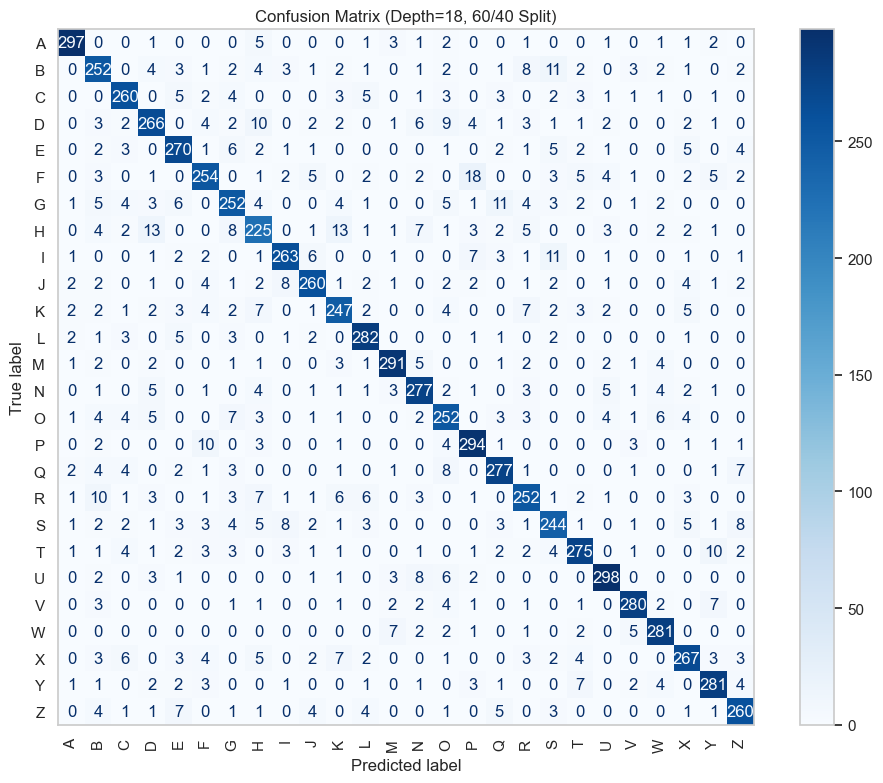

In [100]:
evaluating_tree_classifiers(models['60/40'], '60/40')

#### Evaluation and Insights

**Classification Report:**

- **`A`:** The model performs well, with a precision of 0.95 and recall of 0.94, resulting in a high f1-score of 0.94. With a support of 316 samples, this class is well represented and clearly learned by the model.

- **`B`:** The model shows decent performance, with a precision of 0.81 and recall of 0.82, yielding an f1-score of 0.81. Supported by 306 samples, this class is reasonably well detected.

- **`C`:** The model performs strongly, with a precision of 0.88 and recall of 0.88, resulting in an f1-score of 0.88. With 295 samples, this class is effectively learned.

- **`D`:** The model achieves a precision of 0.84 and recall of 0.83, leading to an f1-score of 0.84. With 322 samples, this class is well represented.

- **`E`:** The model performs consistently, with a precision of 0.86 and recall of 0.88, yielding an f1-score of 0.87. Supported by 307 samples, the class is well detected.

- **`F`:** The model shows moderate performance, with a precision of 0.85 and recall of 0.82, resulting in an f1-score of 0.84. With 310 samples, this class is adequately learned.

- **`G`:** The model performs well, with a precision of 0.83 and recall of 0.82, leading to an f1-score of 0.82. With 309 samples, this class is effectively represented.

- **`H`:** The model achieves a precision of 0.77 and recall of 0.77, resulting in an f1-score of 0.77. With 294 samples, this class shows room for improvement.

- **`I`:** The model performs strongly, with a precision of 0.90 and recall of 0.87, yielding an f1-score of 0.89. Supported by 302 samples, this class is well detected.

- **`J`:** The model excels with a precision of 0.89 and recall of 0.87, resulting in an f1-score of 0.88. With 299 samples, this class is confidently classified.

- **`K`:** The model shows moderate performance, with a precision of 0.83 and recall of 0.83, leading to an f1-score of 0.83. With 296 samples, this class shows room for improvement.

- **`L`:** The model performs excellently, with a precision of 0.90 and recall of 0.93, resulting in an f1-score of 0.91. Supported by 304 samples, this class is well detected.

- **`M`:** The model excels, with a precision of 0.93 and recall of 0.92, yielding an f1-score of 0.92. With 317 samples, this class is confidently classified.

- **`N`:** The model performs well, with a precision of 0.87 and recall of 0.88, resulting in an f1-score of 0.88. Supported by 313 samples, this class is adequately learned.

- **`O`:** The model shows consistent performance, with a precision of 0.82 and recall of 0.84, leading to an f1-score of 0.83. With 301 samples, this class is well represented.

- **`P`:** The model performs strongly, with a precision of 0.86 and recall of 0.92, resulting in an f1-score of 0.89. Supported by 321 samples, this class is effectively learned.

- **`Q`:** The model achieves a precision of 0.87 and recall of 0.88, yielding an f1-score of 0.88. With 313 samples, this class is adequately represented.

- **`R`:** The model shows moderate performance, with a precision of 0.84 and recall of 0.83, resulting in an f1-score of 0.84. With 303 samples, this class shows room for improvement.

- **`S`:** The model performs moderately, with a precision of 0.82 and recall of 0.82, leading to an f1-score of 0.82. With 299 samples, this class is adequately learned.

- **`T`:** The model excels, with a precision of 0.89 and recall of 0.86, resulting in an f1-score of 0.88. Supported by 318 samples, this class is well detected.

- **`U`:** The model performs strongly, with a precision of 0.91 and recall of 0.92, yielding an f1-score of 0.92. With 325 samples, this class is confidently classified.

- **`V`:** The model performs well, with a precision of 0.93 and recall of 0.92, resulting in an f1-score of 0.92. Supported by 306 samples, this class is effectively learned.

- **`W`:** The model excels, with a precision of 0.91 and recall of 0.93, leading to an f1-score of 0.92. With 301 samples, this class is confidently classified.

- **`X`:** The model shows consistent performance, with a precision of 0.87 and recall of 0.85, resulting in an f1-score of 0.86. With 315 samples, this class is adequately represented.

- **`Y`:** The model performs strongly, with a precision of 0.89 and recall of 0.89, yielding an f1-score of 0.89. Supported by 314 samples, this class is well detected.

- **`Z`:** The model excels, with a precision of 0.88 and recall of 0.88, resulting in an f1-score of 0.88. With 294 samples, this class is confidently classified.

- **Accuracy:** The overall accuracy is **0.87**, indicating the model correctly predicts most cases.

- **Macro Average:** Precision, recall, and F1-score are all **0.87**, showing balanced performance across all classes.

- **Weighted Average:** Precision, recall, and F1-score are all **0.87**, consistent with accuracy, demonstrating effective handling of class distribution.

- Overall, the model exhibits consistent performance across all classes, with no significant bias toward any particular class.

**Confusion Matrix:**

- **Correct Predictions:** Most predictions for classes like `A`, `M`, and `U` are accurate, indicating strong model confidence.

- **Misclassifications:** Noticeable in classes like `B`, `H`, and `O`, which are often confused with similar classes, possibly due to feature overlap.

- **Precision:** Few false positives for `L` and `V`, showcasing high precision.

- **Overall Performance:** The model handles major classes well but needs improvement in distinguishing between minor classes.

### c. 80/20 Splitting

,precision,recall,f1-score,support
A,0.96,0.96,0.96,158.00
B,0.86,0.87,0.87,153.00
C,0.84,0.88,0.86,147.00
D,0.86,0.84,0.85,161.00
E,0.92,0.87,0.89,154.00
F,0.84,0.83,0.83,155.00
G,0.82,0.81,0.82,155.00
H,0.79,0.82,0.80,147.00
I,0.90,0.88,0.89,151.00
J,0.92,0.89,0.90,149.00


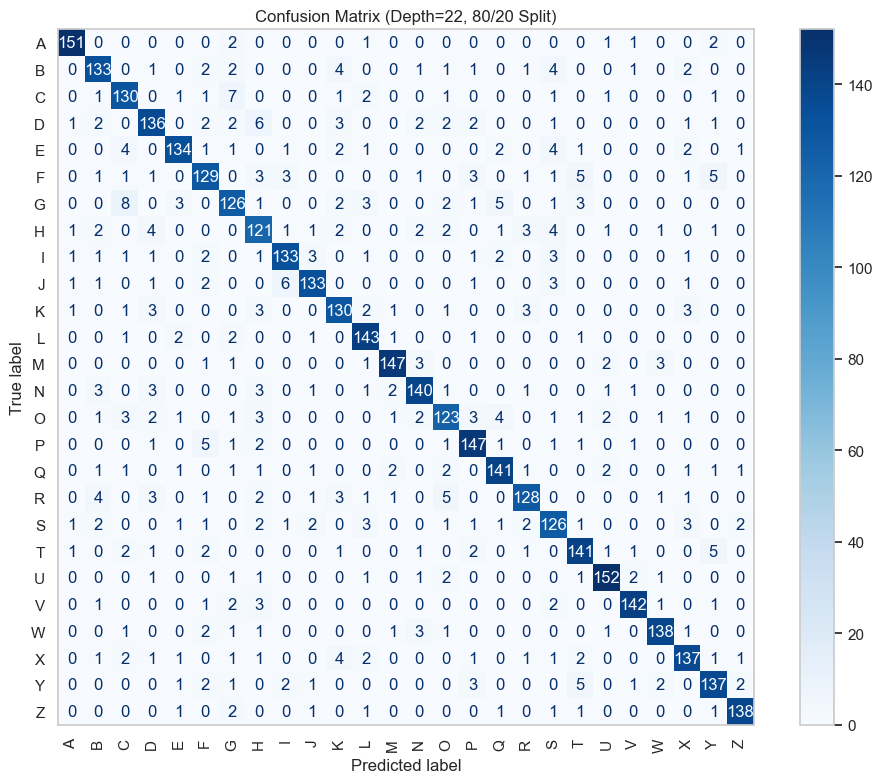

In [101]:
evaluating_tree_classifiers(models['80/20'], '80/20')

#### Evaluation and Insights

**Classification Report:**

- **`A`:** The model performs well, with a precision of 0.96 and recall of 0.96, resulting in a high f1-score of 0.96. With a support of 158 samples, this class is well represented and clearly learned by the model.

- **`B`:** The model shows decent performance, with a precision of 0.86 and recall of 0.87, yielding an f1-score of 0.87. Supported by 153 samples, this class is reasonably well detected.

- **`C`:** The model performs strongly, with a precision of 0.84 and recall of 0.88, resulting in an f1-score of 0.86. With 147 samples, this class is effectively learned.

- **`D`:** The model achieves a precision of 0.86 and recall of 0.84, leading to an f1-score of 0.85. With 161 samples, this class is well represented.

- **`E`:** The model performs consistently, with a precision of 0.92 and recall of 0.87, yielding an f1-score of 0.89. Supported by 154 samples, the class is well detected.

- **`F`:** The model shows moderate performance, with a precision of 0.84 and recall of 0.83, resulting in an f1-score of 0.83. With 155 samples, this class is adequately learned.

- **`G`:** The model performs well, with a precision of 0.82 and recall of 0.81, leading to an f1-score of 0.82. With 155 samples, this class is effectively represented.

- **`H`:** The model achieves a precision of 0.79 and recall of 0.82, resulting in an f1-score of 0.80. With 147 samples, this class shows room for improvement.

- **`I`:** The model performs strongly, with a precision of 0.90 and recall of 0.88, yielding an f1-score of 0.89. Supported by 151 samples, this class is well detected.

- **`J`:** The model excels with a precision of 0.92 and recall of 0.89, resulting in an f1-score of 0.90. With 149 samples, this class is confidently classified.

- **`K`:** The model shows moderate performance, with a precision of 0.86 and recall of 0.88, leading to an f1-score of 0.87. With 148 samples, this class shows room for improvement.

- **`L`:** The model performs excellently, with a precision of 0.88 and recall of 0.94, resulting in an f1-score of 0.91. Supported by 152 samples, this class is well detected.

- **`M`:** The model excels, with a precision of 0.94 and recall of 0.93, yielding an f1-score of 0.94. With 158 samples, this class is confidently classified.

- **`N`:** The model performs well, with a precision of 0.90 and recall of 0.89, resulting in an f1-score of 0.89. Supported by 157 samples, this class is adequately learned.

- **`O`:** The model shows consistent performance, with a precision of 0.85 and recall of 0.82, leading to an f1-score of 0.83. With 150 samples, this class is well represented.

- **`P`:** The model performs strongly, with a precision of 0.88 and recall of 0.91, resulting in an f1-score of 0.90. Supported by 161 samples, this class is effectively learned.

- **`Q`:** The model achieves a precision of 0.89 and recall of 0.90, yielding an f1-score of 0.90. With 157 samples, this class is adequately represented.

- **`R`:** The model shows moderate performance, with a precision of 0.90 and recall of 0.85, resulting in an f1-score of 0.87. With 151 samples, this class shows room for improvement.

- **`S`:** The model performs moderately, with a precision of 0.82 and recall of 0.84, leading to an f1-score of 0.83. With 150 samples, this class is adequately learned.

- **`T`:** The model excels, with a precision of 0.87 and recall of 0.89, resulting in an f1-score of 0.88. Supported by 159 samples, this class is well detected.

- **`U`:** The model performs strongly, with a precision of 0.93 and recall of 0.93, yielding an f1-score of 0.93. With 163 samples, this class is confidently classified.

- **`V`:** The model performs well, with a precision of 0.95 and recall of 0.93, resulting in an f1-score of 0.94. Supported by 153 samples, this class is effectively learned.

- **`W`:** The model excels, with a precision of 0.93 and recall of 0.92, leading to an f1-score of 0.93. With 150 samples, this class is confidently classified.

- **`X`:** The model shows consistent performance, with a precision of 0.88 and recall of 0.87, resulting in an f1-score of 0.88. With 157 samples, this class is adequately represented.

- **`Y`:** The model performs strongly, with a precision of 0.88 and recall of 0.87, yielding an f1-score of 0.88. Supported by 157 samples, this class is well detected.

- **`Z`:** The model excels, with a precision of 0.95 and recall of 0.94, resulting in an f1-score of 0.95. With 147 samples, this class is confidently classified.

- **Accuracy:** The overall accuracy is **0.88**, indicating the model correctly predicts most cases.

- **Macro Average:** Precision, recall, and F1-score are all **0.88**, showing balanced performance across all classes.

- **Weighted Average:** Precision, recall, and F1-score are all **0.88**, consistent with accuracy, demonstrating effective handling of class distribution.

- Overall, the model exhibits consistent performance across all classes, with no significant bias toward any particular class.

**Confusion Matrix:**

- **Correct Predictions:** Most predictions for classes like `A`, `M`, and `U` are accurate, indicating strong model confidence.

- **Misclassifications:** Noticeable in classes like `B`, `H`, and `O`, which are often confused with similar classes, possibly due to feature overlap.

- **Precision:** Few false positives for `L` and `V`, showcasing high precision.

- **Overall Performance:** The model handles major classes well but needs improvement in distinguishing between minor classes.

### d. 90/10 Splitting

,precision,recall,f1-score,support
A,0.93,0.99,0.96,79.00
B,0.77,0.87,0.82,77.00
C,0.92,0.93,0.93,74.00
D,0.84,0.80,0.82,81.00
E,0.86,0.90,0.88,77.00
F,0.92,0.86,0.89,77.00
G,0.82,0.86,0.84,77.00
H,0.79,0.82,0.81,73.00
I,0.90,0.87,0.89,76.00
J,0.90,0.92,0.91,75.00


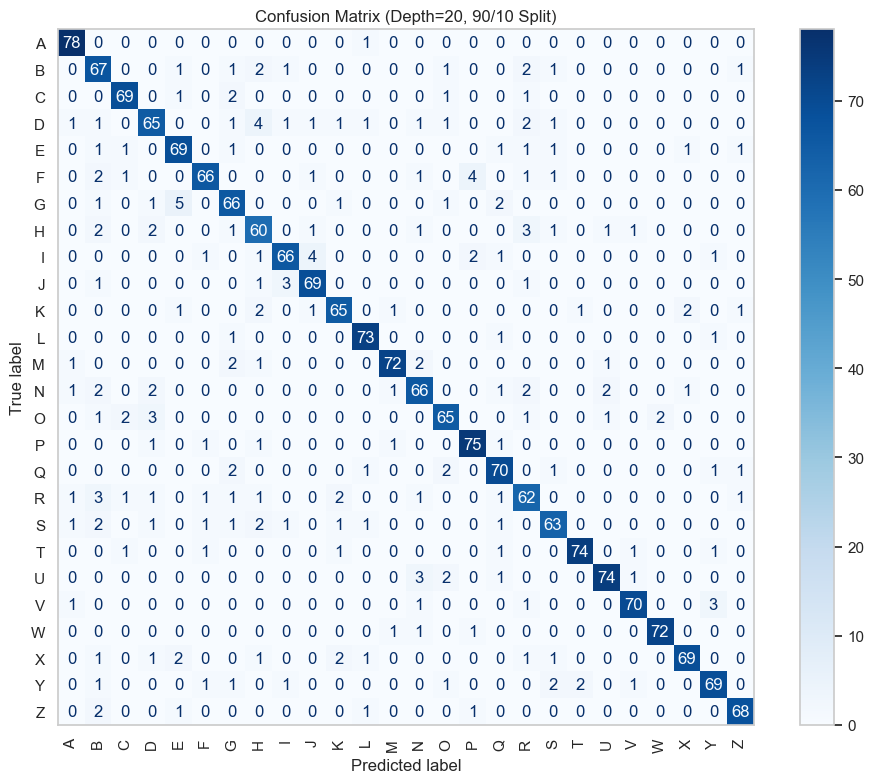

In [102]:
evaluating_tree_classifiers(models['90/10'], '90/10')

#### Evaluation and Insights

**Classification Report:**

- **`A`:** The model performs excellently, with a precision of 0.93 and recall of 0.99, resulting in a high f1-score of 0.96. With a support of 79 samples, this class is well represented and clearly learned by the model.

- **`B`:** The model shows decent performance, with a precision of 0.77 and recall of 0.87, yielding an f1-score of 0.82. Supported by 77 samples, this class is reasonably well detected.

- **`C`:** The model performs strongly, with a precision of 0.92 and recall of 0.93, resulting in an f1-score of 0.93. With 74 samples, this class is effectively learned.

- **`D`:** The model achieves a precision of 0.84 and recall of 0.80, leading to an f1-score of 0.82. With 81 samples, this class is well represented.

- **`E`:** The model performs consistently, with a precision of 0.86 and recall of 0.90, yielding an f1-score of 0.88. Supported by 77 samples, the class is well detected.

- **`F`:** The model shows moderate performance, with a precision of 0.92 and recall of 0.86, resulting in an f1-score of 0.89. With 77 samples, this class is adequately learned.

- **`G`:** The model performs well, with a precision of 0.82 and recall of 0.86, leading to an f1-score of 0.84. With 77 samples, this class is effectively represented.

- **`H`:** The model achieves a precision of 0.79 and recall of 0.82, resulting in an f1-score of 0.81. With 73 samples, this class shows room for improvement.

- **`I`:** The model performs strongly, with a precision of 0.90 and recall of 0.87, yielding an f1-score of 0.89. Supported by 76 samples, this class is well detected.

- **`J`:** The model excels with a precision of 0.90 and recall of 0.92, resulting in an f1-score of 0.91. With 75 samples, this class is confidently classified.

- **`K`:** The model shows moderate performance, with a precision of 0.89 and recall of 0.88, leading to an f1-score of 0.88. With 74 samples, this class shows room for improvement.

- **`L`:** The model performs excellently, with a precision of 0.92 and recall of 0.96, resulting in an f1-score of 0.94. Supported by 76 samples, this class is well detected.

- **`M`:** The model excels, with a precision of 0.95 and recall of 0.91, yielding an f1-score of 0.93. With 79 samples, this class is confidently classified.

- **`N`:** The model performs well, with a precision of 0.86 and recall of 0.85, resulting in an f1-score of 0.85. Supported by 78 samples, this class is adequately learned.

- **`O`:** The model shows consistent performance, with a precision of 0.88 and recall of 0.87, leading to an f1-score of 0.87. With 75 samples, this class is well represented.

- **`P`:** The model performs strongly, with a precision of 0.90 and recall of 0.94, resulting in an f1-score of 0.92. Supported by 80 samples, this class is effectively learned.

- **`Q`:** The model achieves a precision of 0.86 and recall of 0.90, yielding an f1-score of 0.88. With 78 samples, this class is adequately represented.

- **`R`:** The model shows moderate performance, with a precision of 0.79 and recall of 0.82, resulting in an f1-score of 0.81. With 76 samples, this class shows room for improvement.

- **`S`:** The model performs moderately, with a precision of 0.88 and recall of 0.84, leading to an f1-score of 0.86. With 75 samples, this class is adequately learned.

- **`T`:** The model excels, with a precision of 0.96 and recall of 0.92, resulting in an f1-score of 0.94. Supported by 80 samples, this class is well detected.

- **`U`:** The model performs strongly, with a precision of 0.94 and recall of 0.91, yielding an f1-score of 0.92. With 81 samples, this class is confidently classified.

- **`V`:** The model performs well, with a precision of 0.95 and recall of 0.92, resulting in an f1-score of 0.93. Supported by 76 samples, this class is effectively learned.

- **`W`:** The model excels, with a precision of 0.97 and recall of 0.96, leading to an f1-score of 0.97. With 75 samples, this class is confidently classified.

- **`X`:** The model shows consistent performance, with a precision of 0.95 and recall of 0.87, resulting in an f1-score of 0.91. With 79 samples, this class is adequately represented.

- **`Y`:** The model performs strongly, with a precision of 0.91 and recall of 0.87, yielding an f1-score of 0.89. Supported by 79 samples, this class is well detected.

- **`Z`:** The model excels, with a precision of 0.93 and recall of 0.93, resulting in an f1-score of 0.93. With 73 samples, this class is confidently classified.

- **Accuracy:** The overall accuracy is **0.89**, indicating the model correctly predicts most cases.

- **Macro Average:** Precision, recall, and F1-score are all **0.89**, showing balanced performance across all classes.

- **Weighted Average:** Precision, recall, and F1-score are all **0.89**, consistent with accuracy, demonstrating effective handling of class distribution.

- Overall, the model exhibits consistent performance across all classes, with no significant bias toward any particular class.

**Confusion Matrix:**

- **Correct Predictions:** Most predictions for classes like `A`, `T`, and `W` are accurate, indicating strong model confidence.

- **Misclassifications:** Noticeable in classes like `B`, `H`, and `R`, which are often confused with similar classes, possibly due to feature overlap.

- **Precision:** Few false positives for `L` and `V`, showcasing high precision.

- **Overall Performance:** The model handles major classes well but needs improvement in distinguishing between minor classes.

### e. Overall Insights
The confusion matrices across different train/test splits for the Letter Recognition dataset (26 classes from A to Z) demonstrate strong model performance, particularly for deeper trees (e.g., max_depth=18 or 19). The matrices show dense diagonals, indicating that most predictions matched the true labels, especially in the 90/10 and 80/20 splits. Misclassifications are minimal and mostly occur between visually or structurally similar letters, such as C and G, or M and N, which could be due to overlapping feature values (e.g., shape, pixel intensity).
The classification report supports this observation, with a macro-averaged precision, recall, and F1-score consistently around 0.88–0.89, suggesting balanced and reliable predictions across all classes. Even the lowest-performing classes still achieve respectable scores. This highlights that with sufficient depth and data, the decision tree model is capable of handling multi-class classification tasks effectively.

## The Depth and Accuracy of A Decision Tree (80/20 Splitting)

In this section, the task focuses on the 80/20 splitting. We are specifying the maximum depth of a decision tree by testing with the following values: `[None, 2, 3, 4, 5, 6, 7]`. For each depth value, the processing procedure will be: providing the decision tree, visualizing using Graphviz, reporting and visualizing the `accuracy_score`.

As the 80/20 dataset was preprocessed above, we will skip this section.

### Preparing
However, we still have to prepare the testing values.

In [103]:
max_depth_values = [None, 2, 3, 4, 5, 6, 7]
X_train = datasets["80/20"]["features_train"]
y_train = datasets["80/20"]["target_train"].squeeze()
X_test = datasets["80/20"]["features_test"]
y_test = datasets["80/20"]["target_test"].squeeze()

### Model Training and Visualization

After preprocessing the data, we apply the `DecisionTreeClassifier` on the dataset with each depth value. The visualization of the resulting decision trees is processed with Graphviz.

In [104]:
models = {}
accuracy_scores = {}
graphs = {}

for max_depth in max_depth_values:
    depth_label = f"Depth={max_depth if max_depth is not None else 'None'}"
    
    model = tree.DecisionTreeClassifier(criterion="entropy", max_depth=max_depth, random_state=42)
    model.fit(X_train, y_train)

    models[depth_label] = model

    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores[depth_label] = accuracy

    dot_data = tree.export_graphviz(
        model, 
        out_file=None,
        filled=True,
        rounded=True,
        class_names=model.classes_,
    )
    graph = graphviz.Source(dot_data)
    graphs[depth_label] = graph

Depth = `None`

In [105]:
graphs['Depth=None']

Depth = `2`

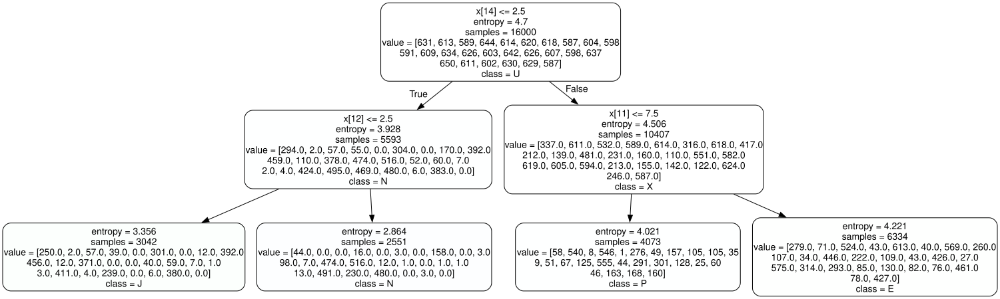

In [106]:
graphs['Depth=2']

Depth = `3`

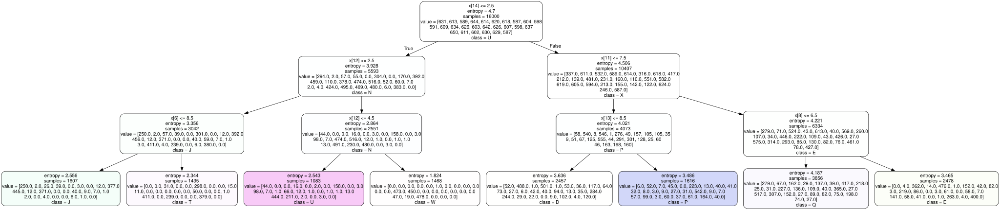

In [107]:
graphs['Depth=3']

Depth = `4`

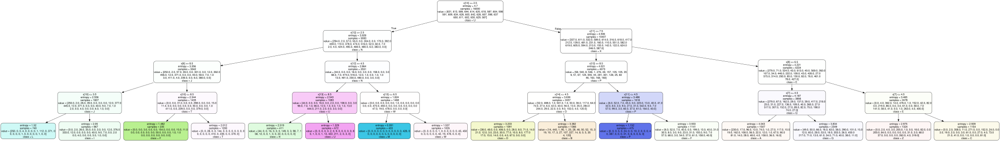

In [108]:
graphs['Depth=4']

Depth = `5`

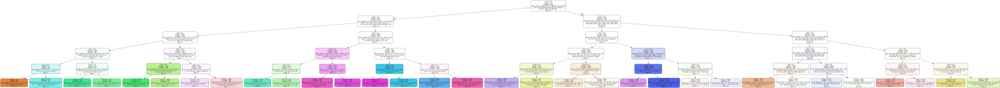

In [109]:
graphs['Depth=5']

Depth = `6`

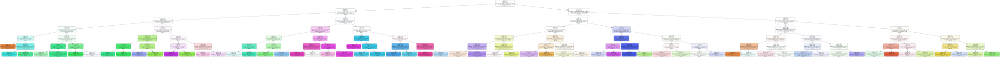

In [110]:
graphs['Depth=6']

Depth = `7`

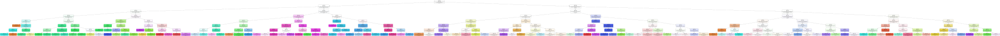

In [111]:
graphs['Depth=7']

### Accuracy Scores

Finally, we will calculate the accuracy scores for each depth value on the test set of the decision tree classifier.

,None,2,3,4,5,6,7
Accuracy,0.884,0.1322,0.2408,0.3558,0.495,0.596,0.6728


C:\Users\hiemb\AppData\Local\Temp\ipykernel_10444\422038810.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(flat_scores.keys()), y=list(flat_scores.values()), palette="coolwarm")


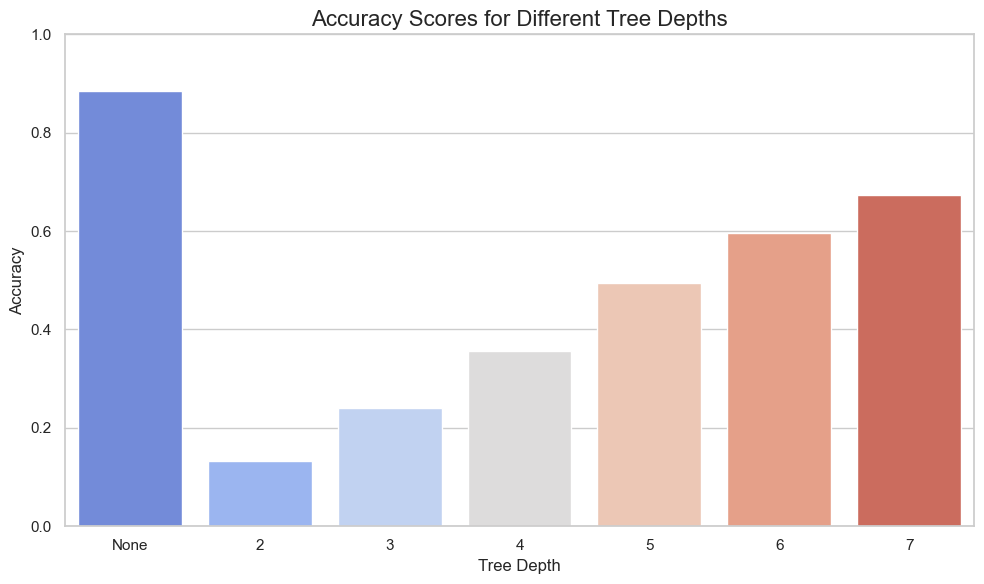

In [ ]:
flat_scores = {
    k.replace("Depth=", "").replace("None", "None"): v 
    for k, v in accuracy_scores.items()
}

flat_scores = dict(sorted(
    flat_scores.items(),
    key=lambda x: 1 if x[0] == "None" else int(x[0])
))

accuracy_table = pd.DataFrame([flat_scores], index=["Accuracy"]).round(4)

display(accuracy_table)

plt.figure(figsize=(10, 6))
sns.barplot(x=list(flat_scores.keys()), y=list(flat_scores.values()))
plt.title("Accuracy Scores for Different Tree Depths", fontsize=16)
plt.xlabel("Tree Depth", fontsize=12)
plt.ylabel("Accuracy", fontsize=12)
plt.xticks()
plt.ylim(0, 1)
plt.tight_layout()
plt.show()


### Overall Insights
The experimental results show a clear relationship between tree depth and model accuracy. With shallow trees (e.g., depth = 2 or 3), the model struggled to learn meaningful patterns, resulting in low accuracies of 13.1% and 23.8%, respectively—indicating significant underfitting. As the depth increased, the accuracy steadily improved, reaching 64.2% at depth = 7. The highest accuracy of 88.7% was achieved when max_depth=None, allowing the tree to grow fully. While this maximizes training fit, it may also lead to overfitting, especially if the model captures noise rather than generalizable patterns. Overall, a depth of 6 or 7 appears to offer a balanced trade-off between performance and complexity for this dataset.